In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

from superpoint.settings import EXPER_PATH
import superpoint.evaluations.descriptor_evaluation as ev
from utils import plot_imgs
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [4]:
def draw_matches(data):
    keypoints1 = [cv2.KeyPoint(p[1], p[0], 1) for p in data['keypoints1']]
    keypoints2 = [cv2.KeyPoint(p[1], p[0], 1) for p in data['keypoints2']]
    inliers = data['inliers'].astype(bool)
    if np.any(inliers):
        matches = np.array(data['matches'])[inliers].tolist()
    else:
        matches = []
    
    img1_bw = np.uint8(output['image1'])
    img2_bw = np.uint8(output['image2'])
    
    img1 = np.concatenate([img1_bw, img1_bw, img1_bw], axis=2)
    img2 = np.concatenate([img2_bw, img2_bw, img2_bw], axis=2)

    return cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches,
                           None, matchColor=(0,255,0), singlePointColor=(0, 0, 255))

# Changes in viewpoint

In [11]:
experiments = ['chain_one_image_aerial/sp_descriptors_tmp',
               'chain_one_image_aerial/sp_descriptors',
               #'chain_one_image_coco/sp_descriptors_no_switch_tmp',
               #'chain_one_image_coco/sp_descriptors_no_switch_tmp_two',
               'chain_one_image_aerial_two/sp_descriptors',
               #'chain_one_image_aerial_three/sp_descriptors',
               'chain_one_image_icip_two/sp_descriptors',
               'chain_one_image_icip_two/sp_descriptors_no_warp',
               'chain_one_image_icip_three/sp_descriptors',
               'chain_one_image_icip_three/sp_descriptors_no_warp',
               #'chain_one_image_icip/sp_descriptors_final_final',
               'chain_one_image_icip/sp_descriptors_final_final_final',
               'chain_one_image_icip/sp_descriptors_no_warp'
               #'chain_one_image_icip/sp_descriptors',
               #'chain_one_image_icip/sp_descriptors_tmp',
               #'chain_one_image_icip/sp_descriptors_one_sided',
               #'chain_one_image_icip/sp_descriptors_final'
]

### Images visualization

Matches found: 1
Matches found: 1
Matches found: 24
Matches found: 63
Matches found: 81
Matches found: 26
Matches found: 97
Matches found: 19
Matches found: 71


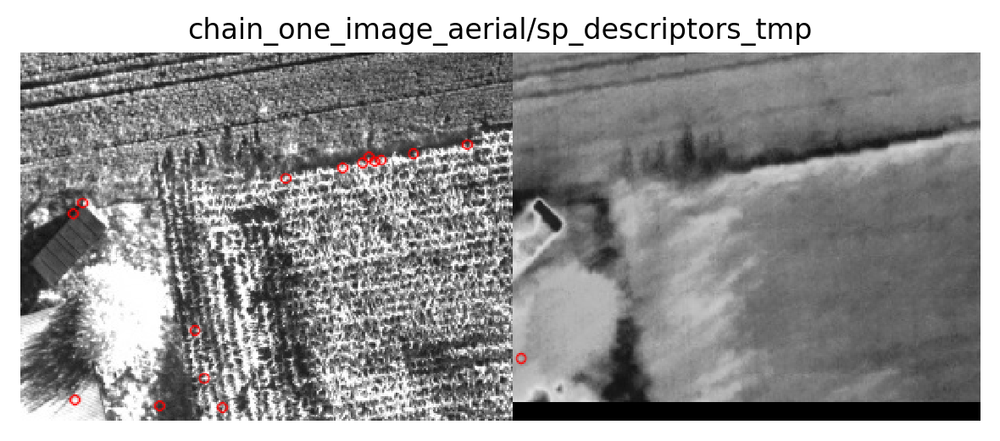

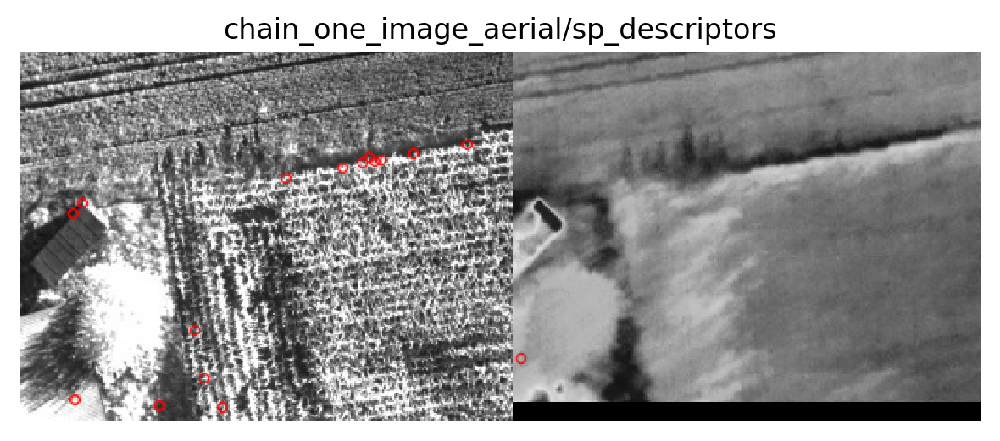

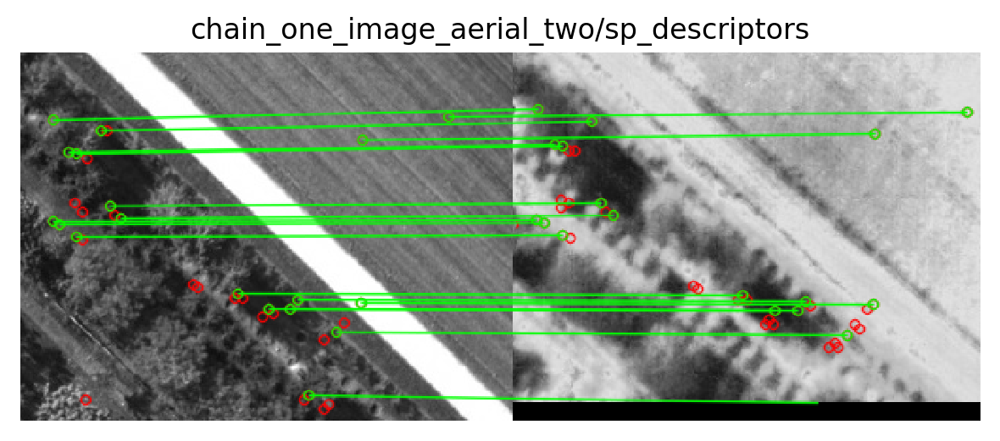

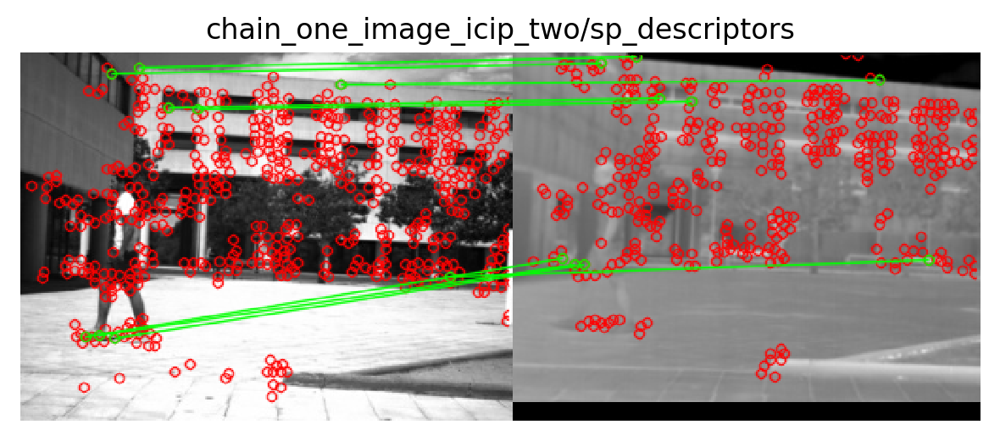

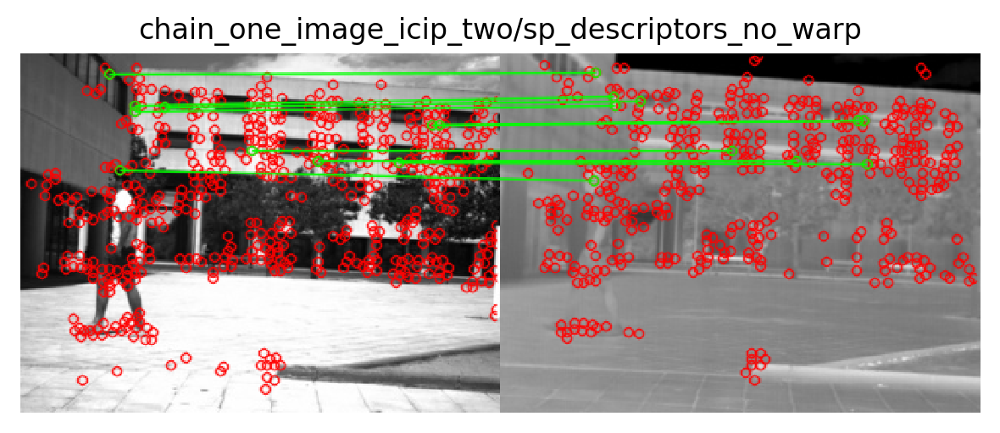

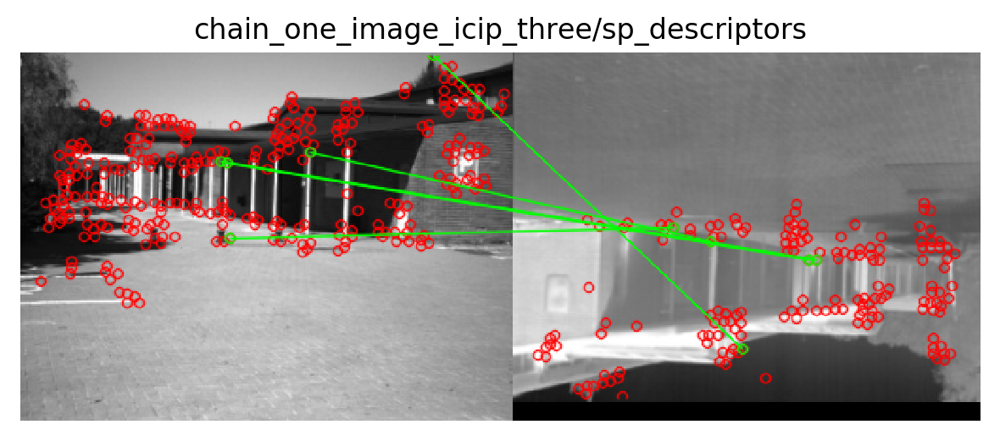

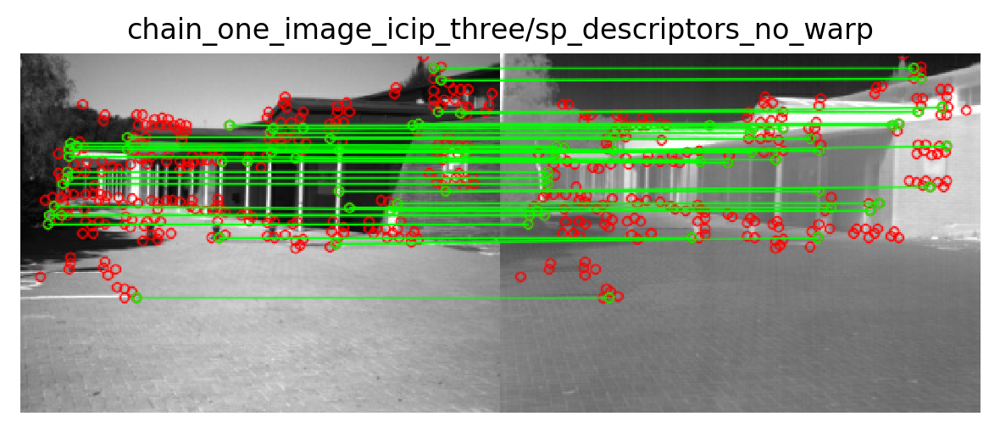

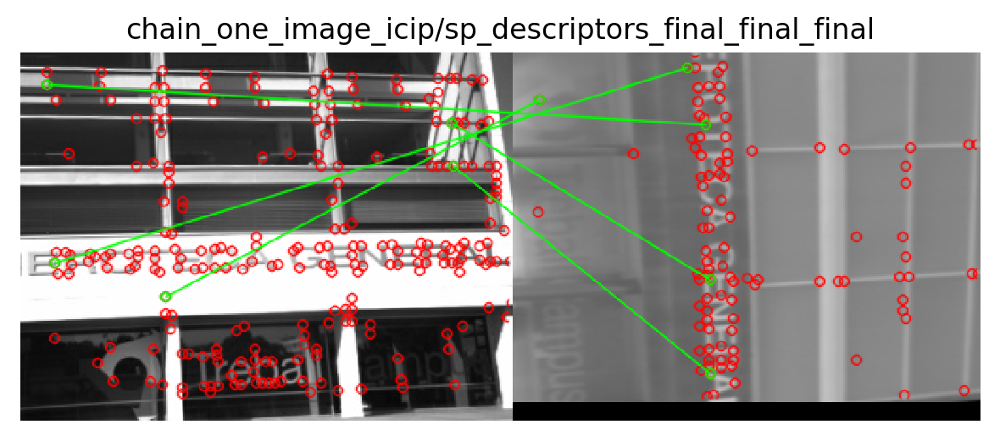

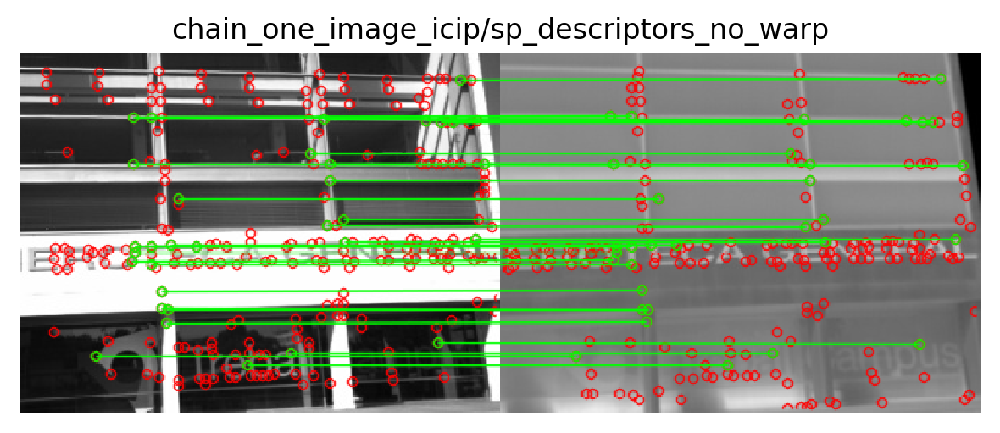

In [12]:
num_images = 10
for e in experiments:
    orb = True if e[:3] == 'orb' else False
    outputs = ev.get_homography_matches(e, keep_k_points=1000, correctness_thresh=5, num_images=num_images, orb=orb)
    for output in outputs:
        img = draw_matches(output) / 255.
        plot_imgs([img], titles=[e], dpi=200)

### Homography estimation correctness

In [17]:
for exp in experiments:
    orb = True if exp[:3] == 'orb' else False
    correctness = ev.homography_estimation(exp, keep_k_points=100, correctness_thresh=100, orb=orb)
    print('> {}: {}'.format(exp, correctness))

Matches found: 15
> chain_one_image_aerial/sp_descriptors_tmp: 0.0
Matches found: 15
> chain_one_image_aerial/sp_descriptors: 0.0
Matches found: 100
> chain_one_image_coco/sp_descriptors_no_switch_tmp: 0.0
Matches found: 100
> chain_one_image_coco/sp_descriptors_no_switch_tmp_two: 0.0
Matches found: 31
> chain_one_image_aerial/sp_descriptors_final: 1.0
Matches found: 100
> chain_one_image_icip/sp_descriptors_final_final: 0.0


### Check that the image is warped correctly

Matches found: 74
Matches found: 5
No matches found
Matches found: 16
Matches found: 117
Matches found: 8
Matches found: 29
Matches found: 2
Matches found: 1
Matches found: 136
Matches found: 8
Matches found: 27
Matches found: 37
Matches found: 1
Matches found: 73
Matches found: 59
Matches found: 83
Matches found: 6
Matches found: 6
Matches found: 24
Matches found: 20
No matches found
Matches found: 40
Matches found: 79
Matches found: 4
Matches found: 27
Matches found: 2
Matches found: 1
Matches found: 11
Matches found: 38
Matches found: 78
Matches found: 3
Matches found: 128
Matches found: 113
Matches found: 170
Matches found: 2
Matches found: 10
Matches found: 4
Matches found: 91
Matches found: 30
Matches found: 2
Matches found: 76
Matches found: 36
Matches found: 8
Matches found: 25
Matches found: 13
Matches found: 36
Matches found: 8
Matches found: 4
Matches found: 8


/cluster/apps/python/3.6.4/lib64/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


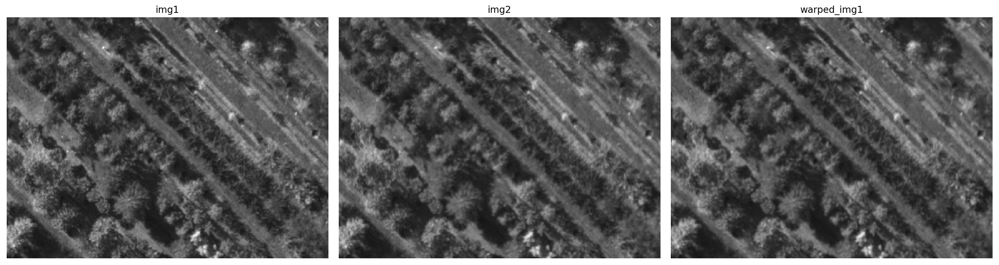

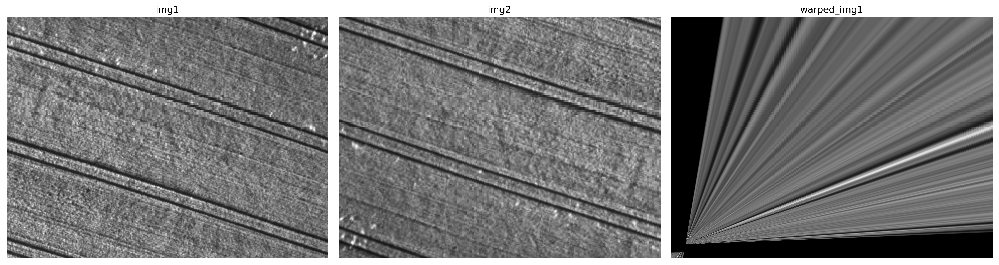

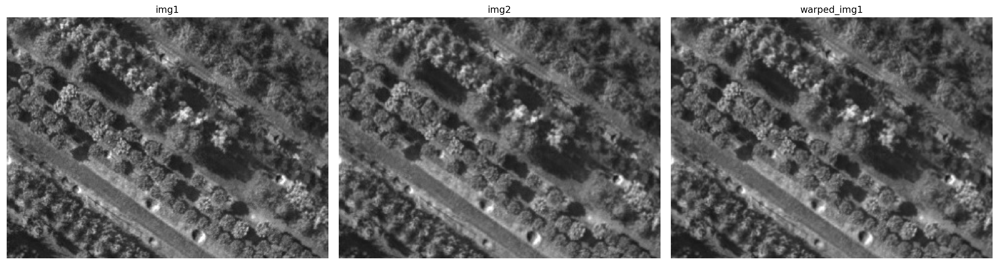

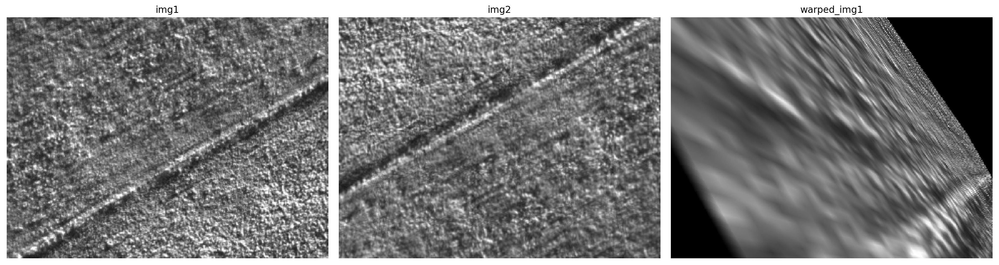

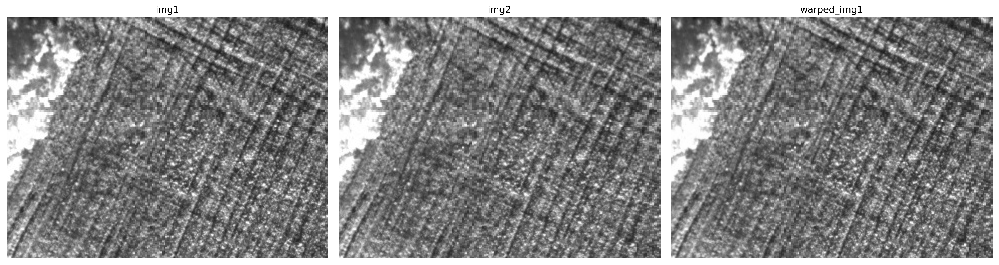

...

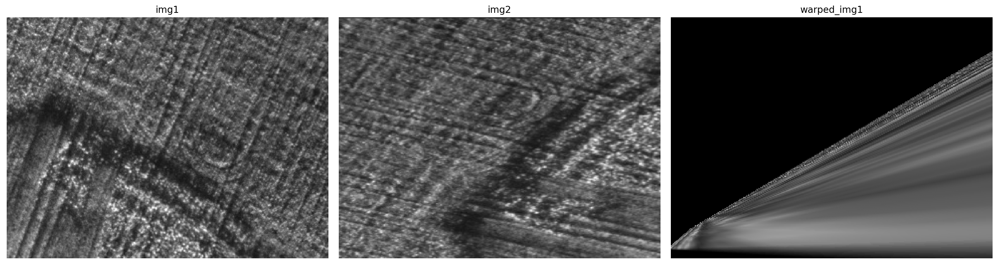

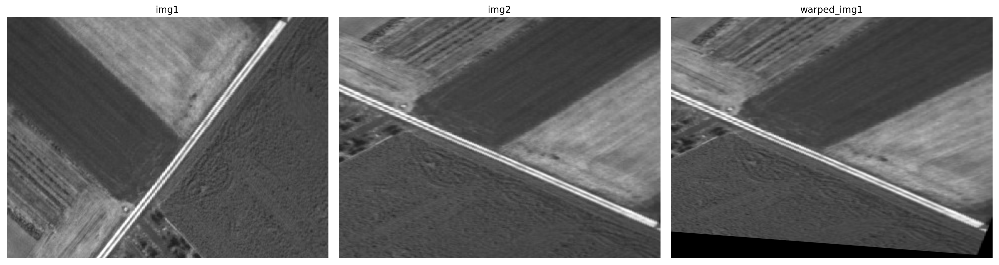

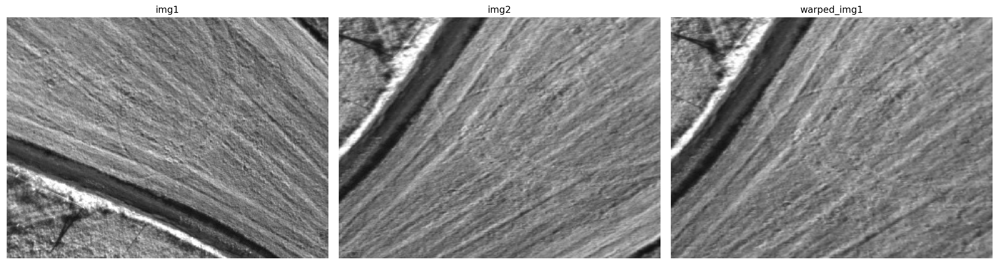

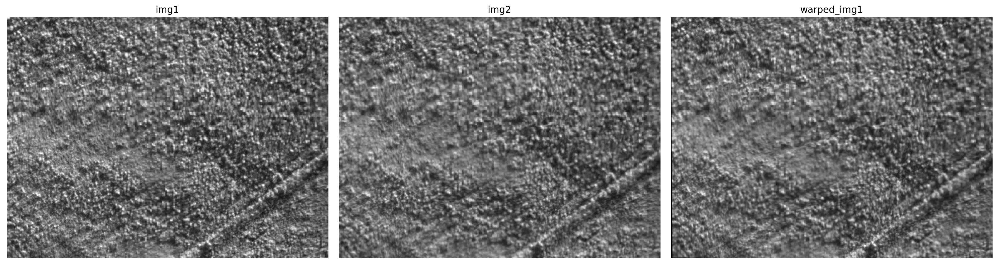

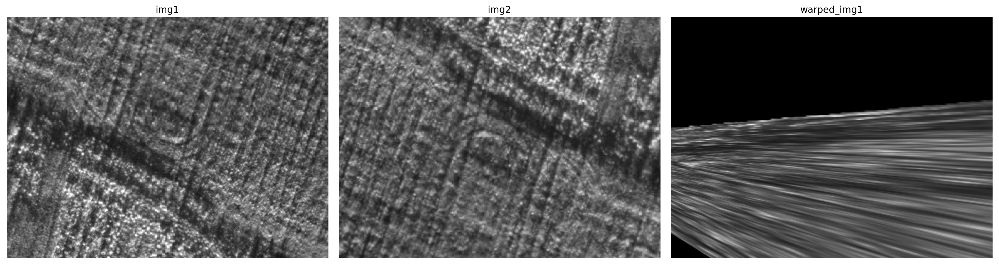

In [18]:
num_images = 50
for e in experiments:
    orb = True if e[:3] == 'orb' else False
    outputs = ev.get_homography_matches(e, keep_k_points=1000, correctness_thresh=3, num_images=num_images, orb=orb)
    for output in outputs:
        img1 = output['image1']
        img2 = output['image2']
        H = output['homography']
        if np.any(H):
            warped_img1 = cv2.warpPerspective(img1, H, (img2.shape[1], img2.shape[0]))
            img1 = np.concatenate([img1, img1, img1], axis=2)
            warped_img1 = np.stack([warped_img1, warped_img1, warped_img1], axis=2)
            img2 = np.concatenate([img2, img2, img2], axis=2)
            plot_imgs([img1 / 255., img2 / 255., warped_img1 / 255.], titles=['img1', 'img2', 'warped_img1'], dpi=200)